# Advanced Lane Finding
The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.


## Used Libraries

In [1]:
import glob
import cv2
import pickle
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

## Camera Calibration
There are two main steps to this process: use chessboard images to image points and object points, and then use the OpenCV functions cv2.calibrateCamera() and cv2.undistort() to compute the calibration and undistortion.

In [2]:
def caliberate_camera(nx, ny, files, show_images = False):
    
    objp = np.zeros((nx * ny, 3), np.float32)  # prepare object points, e.g. (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1, 2)  # x-, y-coordinates

    objpoints = [] # 3d points (space)
    imgpoints = [] # 2d points (image)

    for file in files:   # search chessboard corners

        img = cv2.imread(file)
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

        ret, corners = cv2.findChessboardCorners(gray, (nx, ny),None)  # find chessboard corners

        if ret == True:  # add object- and image-points

            objpoints.append(objp)
            imgpoints.append(corners)
            
            img = cv2.drawChessboardCorners(img, (nx, ny), corners, ret)  # show corners
            
            if show_images == True:
                
                plt.imshow(img)
                plt.show()

    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[0:2], None, None)
    
    if show_images == True:
        
        dist_img = cv2.imread('./camera_cal/calibration1.jpg')
        
        # apply undistrotion
        undist_img = cv2.undistort(dist_img, mtx, dist, None, mtx)
        
        # Visualize undistortion
        f, (ax1, ax2) = plt.subplots(1, 2, figsize = (20, 10))

        ax1.imshow(dist_img)
        ax1.set_title('Original Image', fontsize = 30)
        ax2.imshow(undist_img)
        ax2.set_title('Undistorted Image', fontsize = 30)
        plt.show()

    return mtx, dist

### Applying Camera Calibration

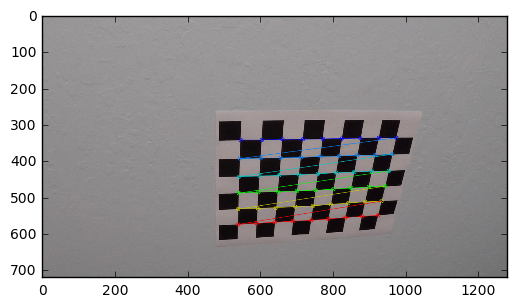

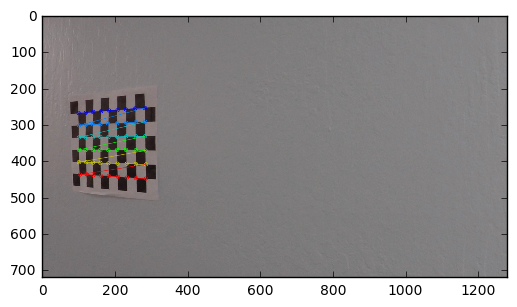

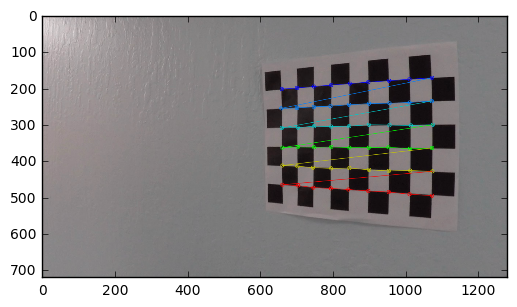

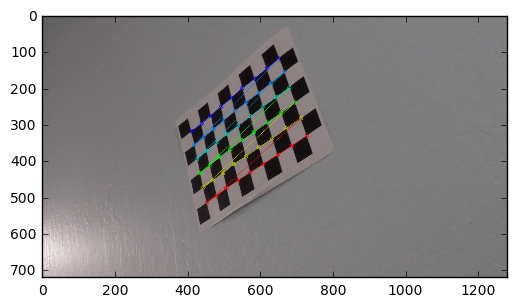

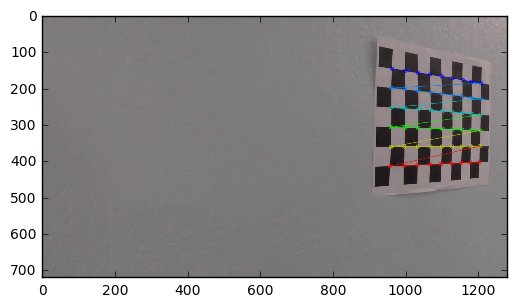

...

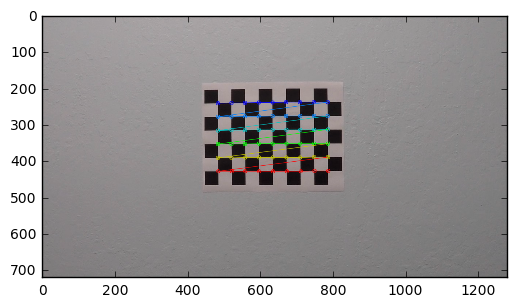

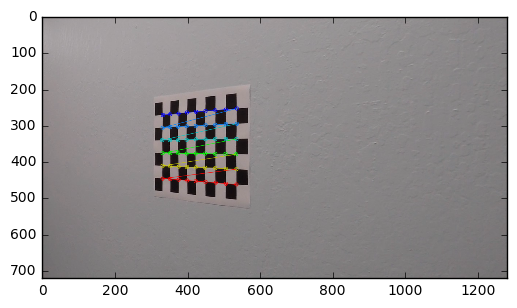

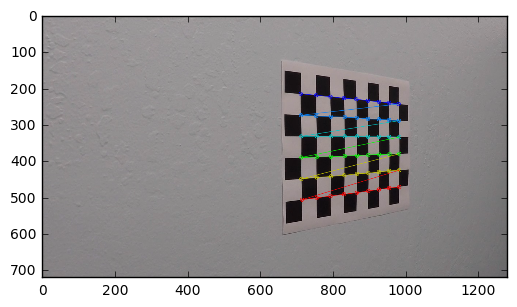

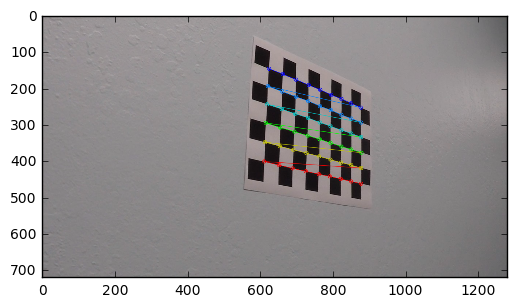

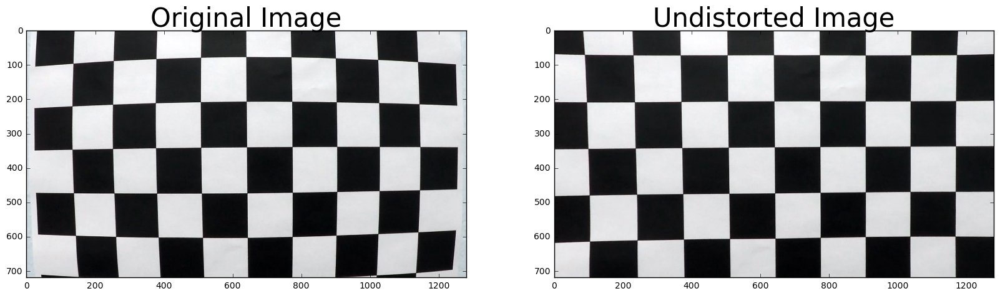

In [3]:
images = glob.glob('./camera_cal/calibration*.jpg')
mtx, dist = caliberate_camera(9, 6, images, show_images = True)


## Thresholds
To find the lane lines the images has to be prepared. E.g. to find the lines close to vertical there will be used the sobel operator.

### Sobel Operator
The Sobel operator is at the heart of the Canny edge detection algorithm. Applying the Sobel operator to an image is a way of taking the derivative of the image in the x or y direction. 

In [4]:
def abs_sobel_thresh(img, orient = 'x', sobel_kernel = 3, thresh = (0, 255)):
    # Apply the following steps to img

    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    if orient == 'x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
    else:
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1)

    # 3) Take the absolute value of the derivative or gradient
    abs_sobel = np.absolute(sobel)

    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255 * abs_sobel / np.max(abs_sobel))

    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    binary_output = np.zeros_like(scaled_sobel)

    # 6) Return this mask as your binary_output image
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    return binary_output

### Applying Sobel Operator

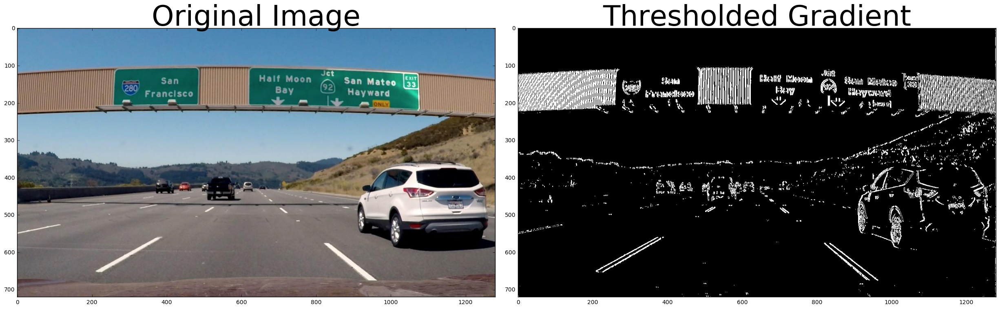

In [5]:
# Read in an image and grayscale it
image = mpimg.imread('./signs_vehicles_xygrad.png')

# Run the function
grad_binary = abs_sobel_thresh(image, orient = 'x', thresh = (20, 100))

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize = (24, 9))
f.tight_layout()

ax1.imshow(image)
ax1.set_title('Original Image', fontsize = 50)
ax2.imshow(grad_binary, cmap='gray')
ax2.set_title('Thresholded Gradient', fontsize = 50)

plt.subplots_adjust(left = 0., right = 1, top = 0.9, bottom = 0.)

### Magnitude of the Gradient
The magnitude, or absolute value, of the gradient is just the square root of the squares of the individual x and y gradients. For a gradient in both the x and y directions, the magnitude is the square root of the sum of the squares.

In [6]:
def mag_thresh(img, sobel_kernel = 3, mag_thresh = (0, 255)):

    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize = sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize = sobel_kernel)

    # 3) Calculate the magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)

    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scale_factor = np.max(gradmag) / 255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 

    # 5) Create a binary mask where mag thresholds are met
    binary_output = np.zeros_like(gradmag)

    # 6) Return this mask as your binary_output image
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    return binary_output

### Applying Magnitude of the Gradient

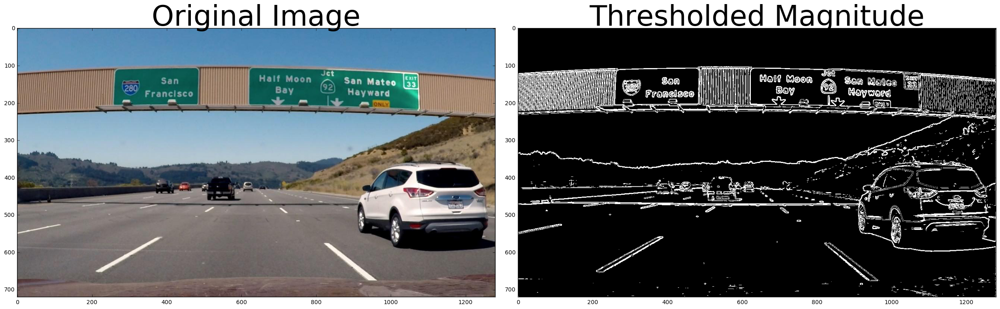

In [7]:
# Run the function
mag_binary = mag_thresh(image, sobel_kernel = 3, mag_thresh = (30, 100))

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize = (24, 9))
f.tight_layout()

ax1.imshow(image)
ax1.set_title('Original Image', fontsize = 50)
ax2.imshow(mag_binary, cmap = 'gray')
ax2.set_title('Thresholded Magnitude', fontsize = 50)

plt.subplots_adjust(left = 0., right = 1, top = 0.9, bottom = 0.)

### Direction of the Gradient
The direction of the gradient is simply the inverse tangent (arctangent) of the y gradient divided by the x gradient. In the case of lane lines, we're interested only in edges of a particular orientation. So now we will explore the direction, or orientation, of the gradient.

In [8]:
def dir_threshold(img, sobel_kernel = 3, thresh = (0, np.pi / 2)):
    
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize = sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize = sobel_kernel)
    
    # 3) 
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    return binary_output

### Applying Direction of the Gradient


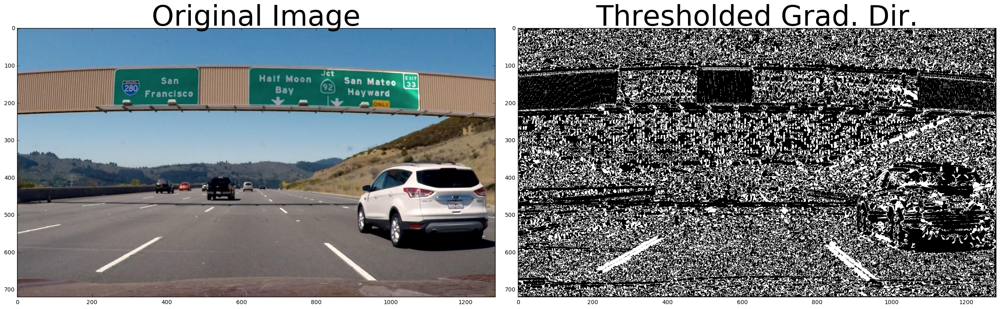

In [9]:
# Run the function
dir_binary = dir_threshold(image, sobel_kernel = 15, thresh = (0.7, 1.3))

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize = (24, 9))
f.tight_layout()

ax1.imshow(image)
ax1.set_title('Original Image', fontsize = 50)
ax2.imshow(dir_binary, cmap = 'gray')
ax2.set_title('Thresholded Grad. Dir.', fontsize = 50)

plt.subplots_adjust(left = 0., right = 1, top = 0.9, bottom = 0.)

### Combining Thresholds
Now we consider how we can use various aspects of your gradient measurements (x, y, magnitude, direction) to isolate lane-line pixels. Specifically, we think about how we can use thresholds of the x and y gradients, the overall gradient magnitude, and the gradient direction to focus on pixels that are likely to be part of the lane lines.

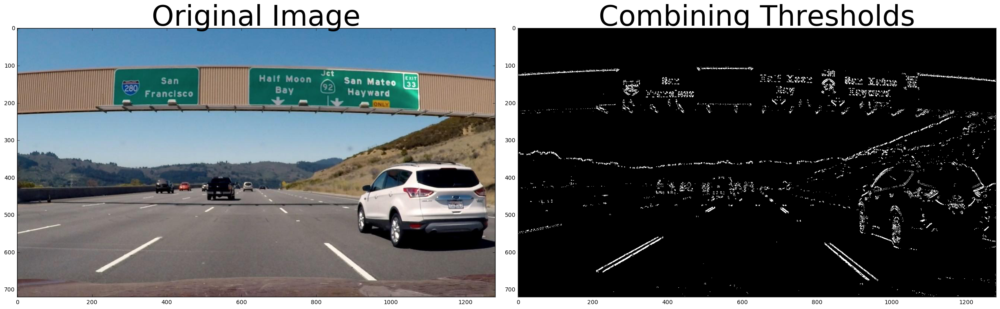

In [10]:
# Choose a Sobel kernel size
ksize = 3 # Choose a larger odd number to smooth gradient measurements

# Apply each of the thresholding functions
gradx = abs_sobel_thresh(image, orient = 'x', sobel_kernel = ksize, thresh = (20, 100))
grady = abs_sobel_thresh(image, orient = 'y', sobel_kernel = ksize, thresh = (20, 100))
mag_binary = mag_thresh(image, sobel_kernel = ksize, mag_thresh = (30, 100))
dir_binary = dir_threshold(image, sobel_kernel=ksize, thresh = (0.7, 1.3))

combined = np.zeros_like(dir_binary)
combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize = (24, 9))
f.tight_layout()

ax1.imshow(image)
ax1.set_title('Original Image', fontsize = 50)
ax2.imshow(combined, cmap = 'gray')
ax2.set_title('Combining Thresholds', fontsize = 50)

plt.subplots_adjust(left = 0., right = 1, top = 0.9, bottom = 0.)

## Pipeline
In the pipeline there is combined color and gradient thresholds, convert to HSV color space and separation of V channel and threshold for color channel.

In [11]:
def pipeline(img, s_thresh = (170, 255), sx_thresh = (20, 100)):

    ksize = 3
    image = np.copy(img)

    gradx = abs_sobel_thresh(image, orient = 'x', sobel_kernel = ksize, thresh = (20, 100))
    grady = abs_sobel_thresh(image, orient = 'y', sobel_kernel = ksize, thresh = (20, 100))

    mag_binary = mag_thresh(image, sobel_kernel = ksize, mag_thresh = (30, 100))
    dir_binary = dir_threshold(image, sobel_kernel = ksize, thresh = (0.7, 1.3))
    
    # Convert to HSV color space and separate the V channel
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)

    h_channel = hsv[:,:,0]
    l_channel = hsv[:,:,1]
    s_channel = hsv[:,:,2]
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    h_binary = np.zeros_like(h_channel)
    h_binary[(h_channel <= 50) & (l_channel >= 100) & (s_channel >= 100)] = 1

    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) |  (h_binary == 1) | ((mag_binary == 1)& (dir_binary == 1))] = 1

    return combined

### Applying Pipeline

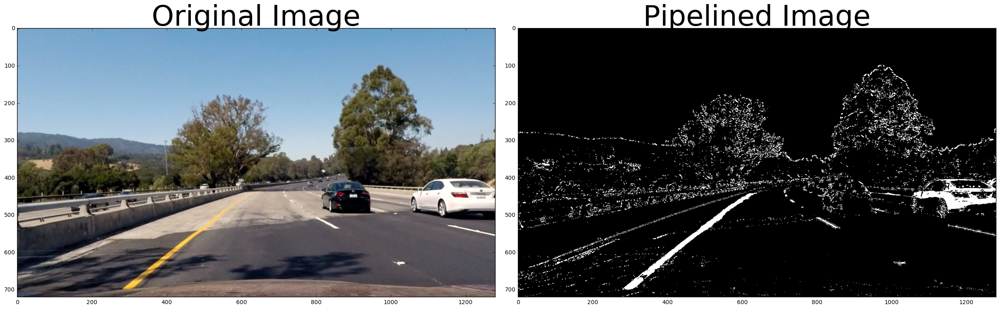

In [12]:
img = cv2.imread('./test_images/test4.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

image = cv2.undistort(img, mtx, dist, None, mtx)

s_thresh = (140, 255)
sx_thresh = (20, 100)

pipelined = pipeline(image, s_thresh = s_thresh, sx_thresh = (20, 100))

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize = (24, 9))
f.tight_layout()

ax1.imshow(image)
ax1.set_title('Original Image', fontsize = 50)

ax2.imshow(pipelined, cmap = 'gray')
ax2.set_title('Pipelined Image', fontsize = 50)

plt.subplots_adjust(left = 0., right = 1, top = 0.9, bottom = 0.)

## Transform
Calculation of the perspective transform matrix and warp images using OpenCV.

### Transform Initializations

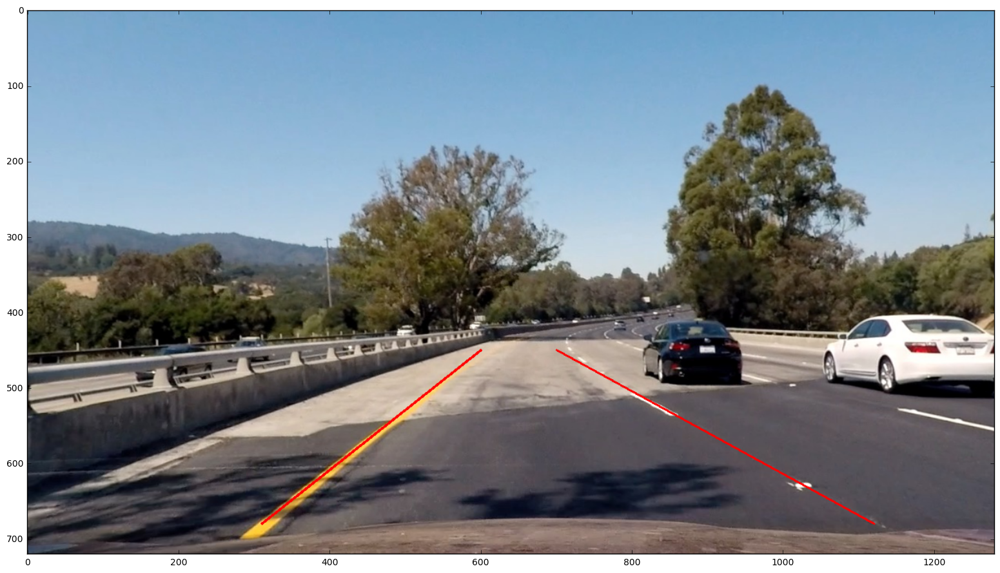

In [13]:
line_img = image.copy()

pl1 = (310, 680)
pl2 = (600, 450)

pr1 = (700, 450)
pr2 = (1120, 680)

cv2.line(line_img, pl1, pl2, (255, 0, 0), thickness = 2)
cv2.line(line_img, pr1, pr2, (255, 0, 0), thickness = 2)

f, ax1 = plt.subplots(1, 1, figsize = (24, 9))
f.tight_layout()

ax1.imshow(line_img)

### Applying Transform

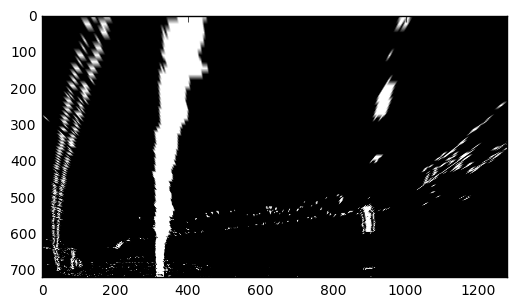

In [14]:
dst_pl1 = (320, 720)
dst_pl2 = (320, 0)

dst_pr1 = (900, 0)
dst_pr2 = (900, 720)

src = np.float32([    pl1,     pl2,     pr1,     pr2])
dst = np.float32([dst_pl1, dst_pl2, dst_pr1, dst_pr2])

M = cv2.getPerspectiveTransform(src, dst)
warped = cv2.warpPerspective(pipelined, M, (pipelined.shape[1], pipelined.shape[0]), flags=cv2.INTER_LINEAR)

plt.imshow(warped, cmap = 'gray')

## Peaks in a Histogram
After applying calibration, thresholding, and a perspective transform to a road image, we have a binary image where the lane lines stand out clearly. However, we still need to decide explicitly which pixels are part of the lines and which belong to the left line and which belong to the right line.

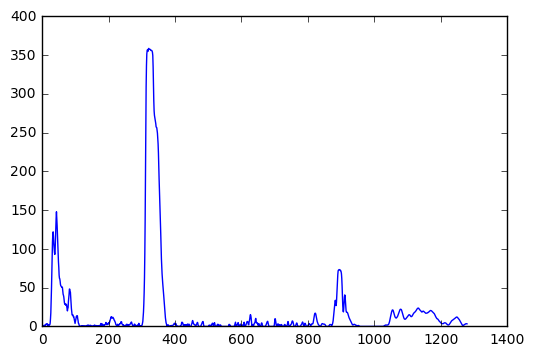

In [15]:
histogram = np.sum(warped[int(warped.shape[0] / 2):,:], axis = 0)
plt.plot(histogram)

## Sliding Window
With the histogram we are adding up the pixel values along each column in the image. In the thresholded binary image, pixels are either 0 or 1, so the two most prominent peaks in this histogram will be good indicators of the x-position of the base of the lane lines. We can use that as a starting point for where to search for the lines. From that point, w can use a sliding window, placed around the line centers, to find and follow the lines up to the top of the frame.

In [18]:
def fit_lanes(binary_warped, test = False):
    
    if test == True:
        out_img = np.dstack((binary_warped, binary_warped, binary_warped)) * 255
        out_img = out_img.astype(np.uint8) 

    binary_warped = binary_warped.copy()
    histogram = np.sum(binary_warped[np.int(binary_warped.shape[0] / 2):,:], axis = 0)  # histogram of bottom half
    
    # find peak
    mid = np.int(histogram.shape[0] / 2)
    left = np.argmax(histogram[100:mid]) + 100
    right = np.argmax(histogram[mid:1200]) + mid
   
    # Choose the number of sliding windows
    nwindows = 9
    
    # set height of windows
    window_height = np.int(binary_warped.shape[0] / nwindows)

    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    # Current positions to be updated for each window
    leftx_current = left
    rightx_current = right
    
    # Set the width of the windows +/- margin
    margin = 100
    
    # Set minimum number of pixels found to recenter window
    minpix = 50
    
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window + 1) * window_height
        win_y_high = binary_warped.shape[0] - window * window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        if test == True:
            
            # Draw the windows on the visualization image
            cv2.rectangle(out_img, (win_xleft_low,win_y_low), (win_xleft_high,win_y_high), (0,255,0), 2) 
            cv2.rectangle(out_img, (win_xright_low,win_y_low), (win_xright_high,win_y_high), (0,255,0), 2) 
            
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:              
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    if test == True:
        
        ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
        
        left_fitx = left_fit[0] * ploty**2 + left_fit[1] * ploty + left_fit[2]
        right_fitx = right_fit[0] * ploty**2 + right_fit[1] * ploty + right_fit[2]
        
        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
        
        fig, ax = plt.subplots(figsize = (10, 7))
        
        plt.imshow(out_img)
        
        plt.plot(left_fitx, ploty, color = 'yellow')
        plt.plot(right_fitx, ploty, color = 'yellow')
        
        plt.xlim(0, 1280)
        plt.ylim(720, 0)

    return left_fit, right_fit, np.max(lefty)


### Applying Sliding Window

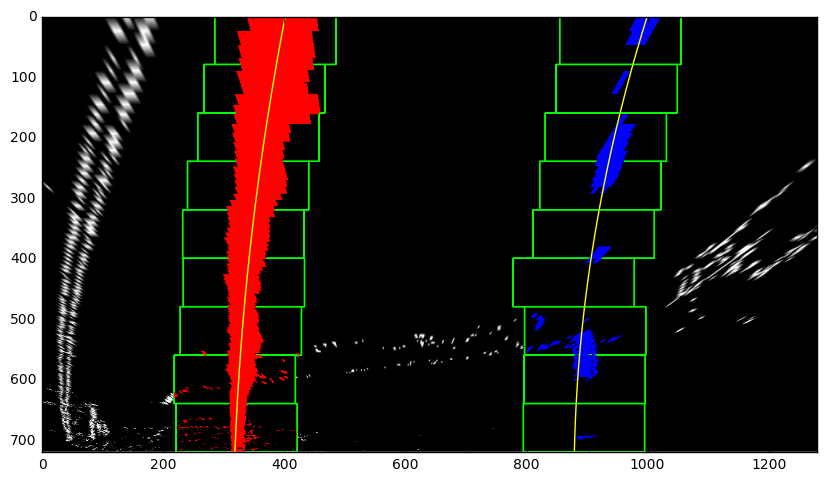

In [19]:
left_fit, right_fit, y_eval = fit_lanes(warped, test = True)

## Curvature
We have a thresholded image, where we've estimated which pixels belong to the left and right lane lines (shown in red and blue, respectively, below), and we've fit a polynomial to those pixel positions. Next we'll compute the radius of curvature of the fit.

In [20]:
def calculate_curvature(left_fit, right_fit):

    ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0] )
    left_fitx = left_fit[0] * ploty**2 + left_fit[1] * ploty + left_fit[2]
    right_fitx = right_fit[0] * ploty**2 + right_fit[1] * ploty + right_fit[2]
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30 / 720  # meters per pixel in y dimension
    xm_per_pix = 3.7 / 700  # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty * ym_per_pix, left_fitx * xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty * ym_per_pix, right_fitx * xm_per_pix, 2)
    
    margin = 100
    nonzero = warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    left_lane_inds = ((nonzerox > (left_fit[0] * (nonzeroy**2) + left_fit[1] * nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0] * (nonzeroy**2) + left_fit[1] * nonzeroy + left_fit[2] + margin))) 
    lefty = nonzeroy[left_lane_inds] 
    y_eval = np.max(lefty)

    # Calculate the new radii of curvature
    left_curverad = ((1 + (2 * left_fit_cr[0] * y_eval * ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2 * left_fit_cr[0])
    right_curverad = ((1 + (2 * right_fit_cr[0] * y_eval * ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2 * right_fit_cr[0])

    return left_curverad, right_curverad

### Applying Calculation of Curvature

In [21]:
left_curverad, right_curverad = calculate_curvature(left_fit, right_fit)

print('Left curve radius: ', left_curverad, 'm')
print('Right curve radius: ', right_curverad, 'm')

Left curve radius:  1550.12399175 m
Right curve radius:  810.588378704 m


## Draw Advanced Lane Lines
Once we have a good measurement of the line positions in warped space, it's time to project our measurement back down onto the road.

In [22]:
def draw(img, warped, Minv, left_fit, right_fit, y_eval, img_size):
    
    ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0])  # generate x and y 
    
    left_fitx = left_fit[0] * ploty**2 + left_fit[1] * ploty + left_fit[2]
    right_fitx = right_fit[0] * ploty**2 + right_fit[1] * ploty + right_fit[2]

    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30 / 720 # meters per pixel in y dimension
    xm_per_pix = 3.7 / 700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty * ym_per_pix, left_fitx * xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty * ym_per_pix, right_fitx * xm_per_pix, 2)

    # Calculate the new radii of curvature
    left_curverad = ((1 + (2 * left_fit_cr[0] * y_eval * ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2 * left_fit_cr[0])
    right_curverad = ((1 + (2 * right_fit_cr[0] * y_eval * ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2 * right_fit_cr[0])

    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, img_size) 

    # Combine the result with the original image
    result = cv2.addWeighted(img, 1, newwarp, 0.3, 0)
    font = cv2.FONT_HERSHEY_SIMPLEX

    cv2.putText(result,'Left radius: %.2f m' %(left_curverad), (50,50), font, 1, (255,255,255), 2, cv2.LINE_AA)
    cv2.putText(result,'Right radius: %.2f m' %(right_curverad), (50,80), font, 1, (255,255,255), 2, cv2.LINE_AA)
    
    left_bottomx = left_fitx[-1]
    right_bottomx = right_fitx[-1]
    center_bottomx = (left_bottomx + right_bottomx) / 2.0
    deviation = np.abs(center_bottomx - warped.shape[1] / 2.0) * xm_per_pix

    cv2.putText(result,'Center offset: %.2f m' %(deviation), (50,110), font, 1, (255,255,255), 2, cv2.LINE_AA)

    return result

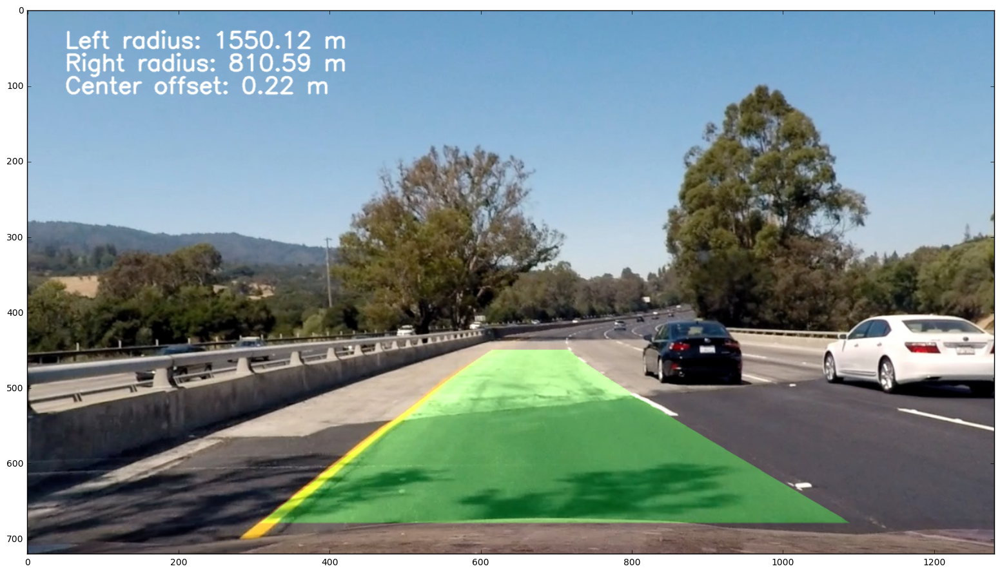

In [23]:
Minv = cv2.getPerspectiveTransform(dst, src)

to_draw = draw(image, warped, Minv, left_fit, right_fit, y_eval, (image.shape[1], image.shape[0]))  # draw image

f, ax1 = plt.subplots(1, 1, figsize=(24, 9))
f.tight_layout()

plt.imshow(to_draw)

## Detection Automation
After we've tuned our pipeline on test images, we're going to automate that e.b. to run on a video stream, just like in the first project. In this case, however, we're going to keep track of things like where our last several detections of the lane lines were and what the curvature was, so we can properly treat new detections. 

In [24]:
def detect(img, mtx, dist, M, Minv, left_detected, left_curr_fit, right_detected, right_curr_fit):

    img = img.copy()
    img = cv2.undistort(img, mtx, dist, None, mtx)
    
    piped_img = pipeline(img, s_thresh = (100, 255))
    warped = cv2.warpPerspective(piped_img, M, (piped_img.shape[1], piped_img.shape[0]), flags=cv2.INTER_LINEAR)

    if left_detected and right_detected:
        left_fit, right_fit, y_eval = fit_detected_lanes(warped, left_lane.curr_fit, right_lane.curr_fit)
    else:        
        left_fit, right_fit, y_eval = fit_lanes(warped)

    left_curverad, right_curverad = calculate_curvature(left_fit, right_fit)

    if left_curr_fit is None:
        left_curr_fit = left_fit

    if right_curr_fit is None:
        right_curr_fit = right_fit

    if left_curverad > right_curverad * 10 or right_curverad > left_curverad * 10:
        left_detected = False
        right_detected = False
    else:
        left_detected = True
        right_detected = True
        left_curr_fit = left_fit
        right_curr_fit = right_fit

    return draw(img, warped, Minv, left_curr_fit, right_curr_fit, y_eval, (img.shape[1], img.shape[0]))  # draw image

### Applying Detection Automation

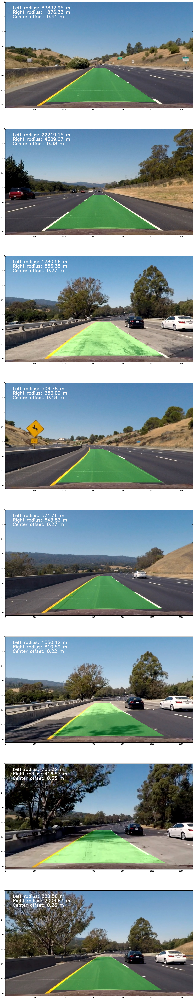

In [25]:
files = glob.glob('./test_images/*.jpg')
f, axarr = plt.subplots(len(files), figsize = (180,100))

for i, file in enumerate(files):

    img = cv2.imread(file)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    left_detected = False  # left line detected in the last iteration?
    left_curr_fit = None  # current fit of left line
    right_detected = False  # right line detected in the last iteration?
    right_curr_fit = None  # current fit of right line
    
    warped = cv2.warpPerspective(img, M, (img.shape[1], img.shape[0]), flags = cv2.INTER_LINEAR)
    detected = detect(img, mtx, dist, M, Minv, left_detected, left_curr_fit, right_detected, right_curr_fit)

    axarr[i].imshow(detected)

plt.show()

## Creating Video Clip

In [26]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

def process_image(image, left_detected, left_curr_fit, right_detected, right_curr_fit):
    
    result = detect(image, mtx, dist, M, Minv, left_detected, left_curr_fit, right_detected, right_curr_fit)
    
    return result

white_output = 'output.mp4'
clip1 = VideoFileClip("project_video.mp4")

left_detected = False  # left line detected in the last iteration?
left_curr_fit = None  # current fit of left line
right_detected = False  # right line detected in the last iteration?
right_curr_fit = None  # current fit of right line

white_clip = clip1.fl_image(lambda image: process_image(image, left_detected, left_curr_fit, right_detected, right_curr_fit)) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio = False)

[MoviePy] >>>> Building video output.mp4
[MoviePy] Writing video output.mp4


100%|█████████████████████████████████████▉| 1260/1261 [10:35<00:00,  2.08it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output.mp4 

Wall time: 10min 36s


## Discussion
The detection of the lane lines can be done if they are existing, of course. There can be also fails if the conditions are not existing for a successfull detection, e.g. in the night or by rain or fog. Another case is if the lines are not marking the road correctly, e.g. in case of overlapping lines when traffic patterns are changing and new lines are drawn over old visible lane lines. Also if lane lines will be interrupted due to road construction.

So, the line detection depends on the thresholding parameters. Therefore a good strategy is to overcome fails is finetuning the thresholds depending on the current conditions according to the driving environment.